# Setup

In [1]:
import zipfile
import os
import sys
from glob import glob

import cv2
import numpy as np
import pandas as pd

import matplotlib as mpl
import matplotlib.cm as cm
import matplotlib.pyplot as plt
import PIL.Image as pil

import torch
from torchvision import transforms

# MONODEPTH
!git clone https://github.com/nianticlabs/monodepth2.git
# sys.path.append("/kaggle/working/monodepth2")

# Uncomment this line if you are running this notebook on your local machine.
sys.path.append("monodepth2/") 

from monodepth2.layers import ConvBlock
from monodepth2.layers import Conv3x3, disp_to_depth
from monodepth2.utils import download_model_if_doesnt_exist
from monodepth2.networks.depth_decoder import DepthDecoder
from monodepth2.networks.resnet_encoder import ResnetEncoder

!git clone https://github.com/ultralytics/yolov5
!pip install -r yolov5/requirements.txt 

fatal: destination path 'monodepth2' already exists and is not an empty directory.
fatal: destination path 'yolov5' already exists and is not an empty directory.
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 922.2/922.2 kB 19.3 MB/s eta 0:00:0000:01


In [2]:
# Download the dataset. 
!curl -O https://s3.eu-central-1.amazonaws.com/avg-kitti/raw_data/2011_09_26_drive_0106/2011_09_26_drive_0106_sync.zip   
!curl -O https://s3.eu-central-1.amazonaws.com/avg-kitti/raw_data/2011_09_26_drive_0106/2011_09_26_drive_0106_extract.zip    
!curl -O https://s3.eu-central-1.amazonaws.com/avg-kitti/raw_data/2011_09_26_calib.zip

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100  893M  100  893M    0     0  20.8M      0  0:00:42  0:00:42 --:--:-- 19.3M
  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100 1317M  100 1317M    0     0  20.4M      0  0:01:04  0:01:04 --:--:-- 22.1M
  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100  4068  100  4068    0     0   7085      0 --:--:-- --:--:-- --:--:--  7087


In [3]:
with zipfile.ZipFile('/kaggle/working/2011_09_26_drive_0106_sync.zip', 'r') as zip_ref:
    zip_ref.extractall('/kaggle/working/data')

with zipfile.ZipFile('/kaggle/working/2011_09_26_drive_0106_extract.zip', 'r') as zip_ref:
    zip_ref.extractall('/kaggle/working/data')

with zipfile.ZipFile('/kaggle/working/2011_09_26_calib.zip', 'r') as zip_ref:
    zip_ref.extractall('/kaggle/working/calib')

In [2]:
data_path = '/kaggle/working/data/2011_09_26/2011_09_26_drive_0106_sync/'
data_path_unrect = '/kaggle/working/data/2011_09_26/2011_09_26_drive_0106_extract/'
calib_path = '/kaggle/working/calib/2011_09_26'

left_image_unrect_paths = sorted(glob(os.path.join(data_path_unrect, 'image_02/data/*.png')))
right_image_unrect_paths = sorted(glob(os.path.join(data_path_unrect, 'image_03/data/*.png')))

left_image_paths = sorted(glob(os.path.join(data_path, 'image_02/data/*.png')))
right_image_paths = sorted(glob(os.path.join(data_path, 'image_03/data/*.png')))

bin_paths = sorted(glob(os.path.join(data_path, 'velodyne_points/data/*.bin')))

with open(os.path.join(calib_path, 'calib_cam_to_cam.txt'),'r') as f:
    cam_calib = f.readlines()
    
with open(os.path.join(calib_path, 'calib_velo_to_cam.txt'),'r') as f:
     velo_calib = f.readlines()

In [3]:
# 3x4 projection matrix after rectification
P_left = np.array([float(x) for x in cam_calib[25].strip().split(' ')[1:]]).reshape((3,4))
P_right = np.array([float(x) for x in cam_calib[33].strip().split(' ')[1:]]).reshape((3,4))

# 3x3 rectifying rotation to make image planes co-planar
R_left_rect = np.array([float(x) for x in cam_calib[24].strip().split(' ')[1:]]).reshape((3, 3,))
R_right_rect = np.array([float(x) for x in cam_calib[32].strip().split(' ')[1:]]).reshape((3, 3,))

# 3x3 calibration matrix of camera xx before rectification
K_left = np.array([float(x) for x in cam_calib[19].strip().split(' ')[1:]]).reshape((3, 3,))
K_right = np.array([float(x) for x in cam_calib[27].strip().split(' ')[1:]]).reshape((3, 3,))

# 1x5 distortion vector of camera xx before rectification
D_left = np.array([float(x) for x in cam_calib[20].strip().split(' ')[1:]]).reshape((1, 5,))
D_right = np.array([float(x) for x in cam_calib[28].strip().split(' ')[1:]]).reshape((1, 5,))

# 1x2 size of image xx before rectification
S_left = np.array([float(x) for x in cam_calib[18].strip().split(' ')[1:]]).reshape((1, 2,))
S_right = np.array([float(x) for x in cam_calib[26].strip().split(' ')[1:]]).reshape((1, 2,))

# 3x3 rotation matrix of camera xx (extrinsic)
R_left = np.array([float(x) for x in cam_calib[21].strip().split(' ')[1:]]).reshape((3, 3,))
R_right = np.array([float(x) for x in cam_calib[29].strip().split(' ')[1:]]).reshape((3, 3,))

# 3x3 rotation matrix and 3x1 translation vector
R_cam_velo = np.array([float(x) for x in velo_calib[1].strip().split(' ')[1:]]).reshape((3, 3))
t_cam_velo = np.array([float(x) for x in velo_calib[2].strip().split(' ')[1:]])[:, None]
T_cam_velo = np.vstack((np.hstack((R_cam_velo, t_cam_velo)),np.array([0, 0, 0, 1])))

# Part 1: Stereo Rectification & Disparity

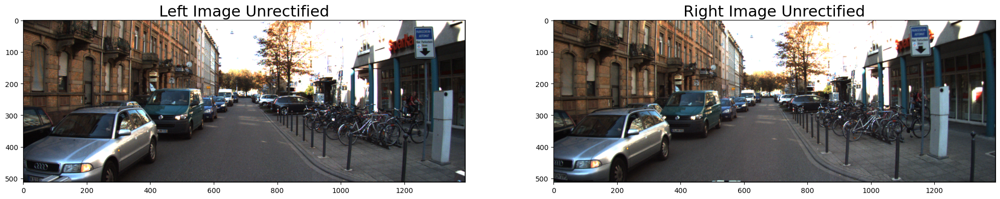

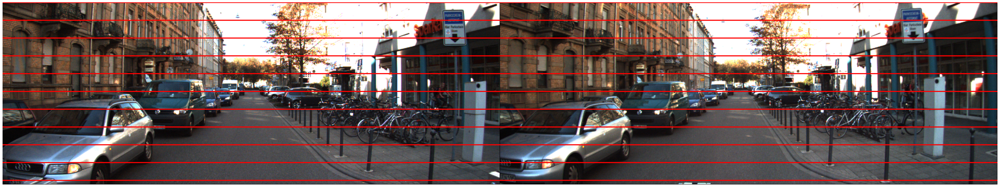

In [4]:
img_index = 80

left_image_unrect = cv2.cvtColor(cv2.imread(left_image_unrect_paths[img_index]), cv2.COLOR_BGR2RGB)
right_image_unrect = cv2.cvtColor(cv2.imread(right_image_unrect_paths[img_index]), cv2.COLOR_BGR2RGB)

_, (ax1, ax2) = plt.subplots(1, 2, figsize=(25, 15))
ax1.imshow(left_image_unrect)
ax1.set_title('Left Image Unrectified', size=22)
ax2.imshow(right_image_unrect)
ax2.set_title('Right Image Unrectified', size=22)

combined = np.hstack((left_image_unrect, right_image_unrect))
for i in range(0, combined.shape[0], 50):  # Draw horizontal lines along every 50 pixels
    cv2.line(combined, (0, i), (combined.shape[1], i), (255, 0, 0), 2)

plt.figure(figsize=(50, 50))
plt.imshow(combined)
plt.axis("off")
plt.show()

# Part 1a: Comment on the epipolar lines.
<span style="color:red">1. Are these images perfectly rectified? Provide reasoning.</span>

<span style="color:blue">Answer: </span>No,this image pair is not fully rectified,rectified image pairs require that the corresponding points lie on the same red horizontal scan line below.More specifically, perfectly rectified image pairs should not be vertically misaligned.Using the red scanning line as a reference, you can see that the headlights, road signs and other objects in the left and right images are not in the same vertical position.


<span style="color:red">2. If the images are not co-planar, how does it impact the stereo depth estimation?</span>.

<span style="color:blue">Answer: </span>No coplanar means that the image pairs are not perfectly rectified，as shown in the uncorrected image above, the corresponding points are not horizontally aligned, and this vertical misalignment can lead to errors in depth estimation, and depth estimation with errors can lead to visual artifacts or noise in the depth map




# Part 1b: Perform stereo rectification on 'left_image_unrect' and 'right_image_unrect'.
* Use the cv2.initUndistortRectifyMap and cv2.remap functions

In [5]:



#
image_size_left = tuple(S_left.flatten().astype(int))  # (width, height)
image_size_right = tuple(S_right.flatten().astype(int))
# left image
map1_left, map2_left = cv2.initUndistortRectifyMap(K_left, D_left, R_left_rect, P_left, image_size_left, cv2.CV_32FC1)
rectified_left = cv2.remap(left_image_unrect, map1_left, map2_left, cv2.INTER_LINEAR)

# right image
map1_right, map2_right = cv2.initUndistortRectifyMap(K_right, D_right, R_right_rect, P_right, image_size_right, cv2.CV_32FC1)
rectified_right = cv2.remap(right_image_unrect, map1_right, map2_right, cv2.INTER_LINEAR)


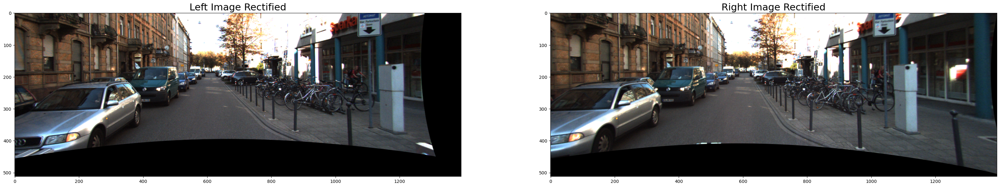

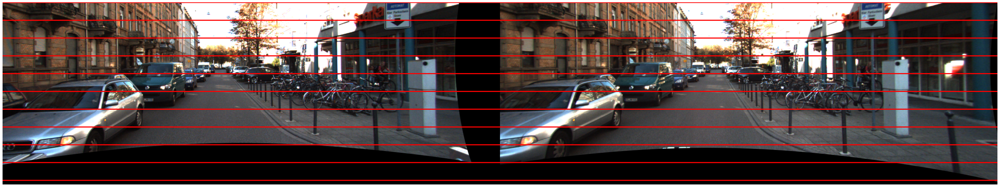

In [6]:
_, (ax1, ax2) = plt.subplots(1, 2, figsize=(40, 40))
ax1.imshow(rectified_left)
ax1.set_title('Left Image Rectified', size=22)
ax2.imshow(rectified_right)
ax2.set_title('Right Image Rectified', size=22)

combined = np.hstack((rectified_left, rectified_right))
for i in range(0, combined.shape[0], 50):  # Draw horizontal lines along every 50 pixels
    cv2.line(combined, (0, i), (combined.shape[1], i), (255, 0, 0), 2)

plt.figure(figsize=(50, 50))
plt.imshow(combined)
plt.axis("off")
plt.show()

# Part 1c) Comment on the epipolar lines after rectification. 
# How do they compare to those in the unrectified images
<span style="color:blue">Answer: </span>I used OpenCV's cv2.initUndistortRectify Map function to implement the stereo image rectification, and after rectification, the antipodal lines in the image are now horizontal in both the left and right rectified images, and are shown by the red scan lines in the figure，corresponding points (e.g. headlights, road signs and other objects) are vertically in the same scan line. This change is a significant change from the unrectified image.This alignment simplifies stereo matching and greatly improves the accuracy and efficiency of stereo depth estimation.


# Part 2: Disparity Map Generation

# Part 2a: Compute the disparity between the two images using a semi global block matching algorithm. 
For ease of use, you may continue the assignment using the pre-rectified images from the dataset, i.e., images in 'left_image_paths' and 'right_image_paths'.

https://en.wikipedia.org/wiki/Semi-global_matching

https://docs.opencv.org/3.4/d2/d85/classcv_1_1StereoSGBM.html


In [22]:
### Complete the function below
def compute_sgbm_disparity(left_image, right_image, num_disparities, 
                           block_size, window_size):
    # Create the StereoSGBM object
    stereo = cv2.StereoSGBM_create(
        minDisparity=0,
        numDisparities=num_disparities,  # Maximum disparity minus minimum disparity
        blockSize=block_size,  # Block size, typically an odd number (5, 7, 9)
        P1=8 * 3 * block_size**2,  # Controls the smoothness of disparity map
        P2=32 * 3 * block_size**2,  # Controls the smoothness of disparity map
        disp12MaxDiff=1,  # Maximum allowed difference in disparity between left and right images
        uniquenessRatio=10,  # Threshold to reject unreliable matches
        speckleWindowSize=window_size,  # Speckle filter window size
        speckleRange=32  # Maximum disparity variation in a speckle
    )
    
    # Compute disparity map
    disparity = stereo.compute(left_image, right_image).astype(np.float32) / 16.0
    
    # Return the disparity map
    return disparity

# Part 2b: Use the function ('compute_sgbm_disparity') and vary the 3 input parameters (num_disparities, block_size, window_size).

* experiment with the 3 input parameters  

# Use num_disparities = 96,block_size = 10,window_size = 100 as reference.

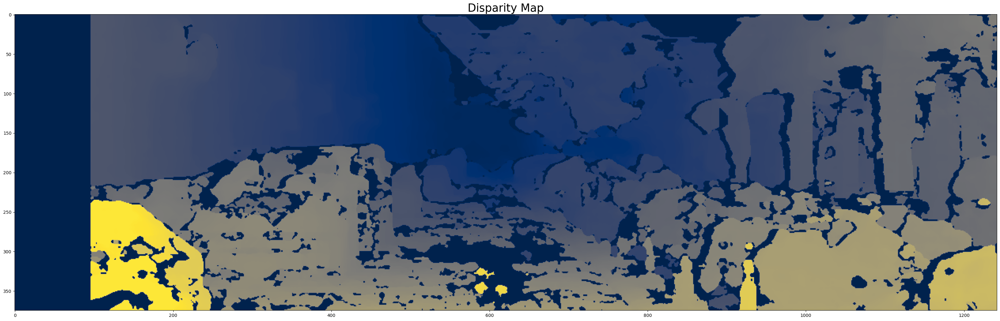

In [33]:
#Use num_disparities = 96,block_size = 10,window_size = 100 as reference.
left_image = cv2.cvtColor(cv2.imread(left_image_paths[img_index]), cv2.COLOR_BGR2RGB)
right_image = cv2.cvtColor(cv2.imread(right_image_paths[img_index]), cv2.COLOR_BGR2RGB)

left_image_gray = cv2.cvtColor(left_image, cv2.COLOR_RGB2GRAY)
right_image_gray = cv2.cvtColor(right_image, cv2.COLOR_RGB2GRAY)

# Use the below values as initial guesses. Try multiple other combinations.
num_disparities =  96 #(6x16)
block_size = 10
window_size = 100
disparity_stereo = compute_sgbm_disparity(left_image_gray, right_image_gray, num_disparities, block_size, window_size)

plt.figure(figsize = (40,40))
plt.imshow(disparity_stereo, cmap='cividis')
plt.title('Disparity Map', size=25)
plt.show()

# block_size = 10 increased to 15

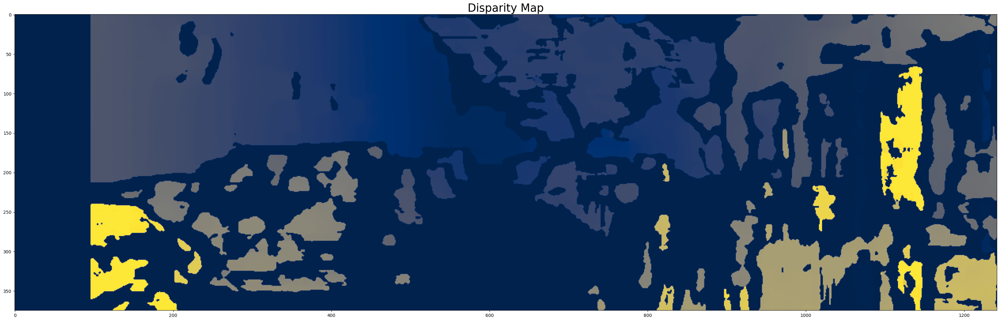

In [34]:
#block_size = 10 increased to 15
left_image = cv2.cvtColor(cv2.imread(left_image_paths[img_index]), cv2.COLOR_BGR2RGB)
right_image = cv2.cvtColor(cv2.imread(right_image_paths[img_index]), cv2.COLOR_BGR2RGB)

left_image_gray = cv2.cvtColor(left_image, cv2.COLOR_RGB2GRAY)
right_image_gray = cv2.cvtColor(right_image, cv2.COLOR_RGB2GRAY)

# Use the below values as initial guesses. Try multiple other combinations.
num_disparities =  96 #(6x16)
block_size = 15
window_size = 100
disparity_stereo = compute_sgbm_disparity(left_image_gray, right_image_gray, num_disparities, block_size, window_size)

plt.figure(figsize = (40,40))
plt.imshow(disparity_stereo, cmap='cividis')
plt.title('Disparity Map', size=25)
plt.show()

# block_size = 10 reduced to 5

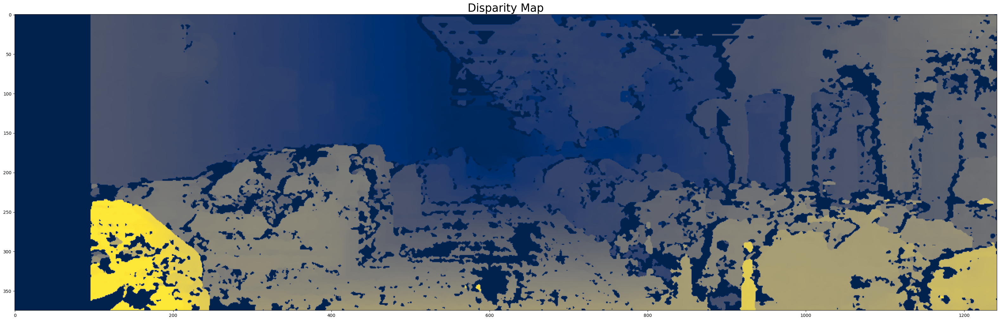

In [35]:
#block_size = 10 reduced to 5
left_image = cv2.cvtColor(cv2.imread(left_image_paths[img_index]), cv2.COLOR_BGR2RGB)
right_image = cv2.cvtColor(cv2.imread(right_image_paths[img_index]), cv2.COLOR_BGR2RGB)

left_image_gray = cv2.cvtColor(left_image, cv2.COLOR_RGB2GRAY)
right_image_gray = cv2.cvtColor(right_image, cv2.COLOR_RGB2GRAY)

# Use the below values as initial guesses. Try multiple other combinations.
num_disparities =  96 #(6x16)
block_size = 5
window_size = 100
disparity_stereo = compute_sgbm_disparity(left_image_gray, right_image_gray, num_disparities, block_size, window_size)

plt.figure(figsize = (40,40))
plt.imshow(disparity_stereo, cmap='cividis')
plt.title('Disparity Map', size=25)
plt.show()

# num_disparities = 96 #(6x16) increased to 320

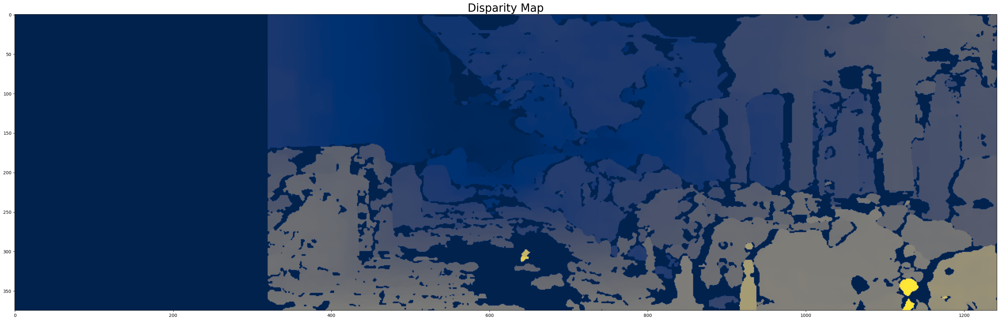

In [36]:
#num_disparities = 96 #(6x16) increased to 320
left_image = cv2.cvtColor(cv2.imread(left_image_paths[img_index]), cv2.COLOR_BGR2RGB)
right_image = cv2.cvtColor(cv2.imread(right_image_paths[img_index]), cv2.COLOR_BGR2RGB)

left_image_gray = cv2.cvtColor(left_image, cv2.COLOR_RGB2GRAY)
right_image_gray = cv2.cvtColor(right_image, cv2.COLOR_RGB2GRAY)

# Use the below values as initial guesses. Try multiple other combinations.
num_disparities =  320 #(20x16)
block_size = 10
window_size = 100
disparity_stereo = compute_sgbm_disparity(left_image_gray, right_image_gray, num_disparities, block_size, window_size)

plt.figure(figsize = (40,40))
plt.imshow(disparity_stereo, cmap='cividis')
plt.title('Disparity Map', size=25)
plt.show()

# num_disparities = 96 #(6x16) reduced to 32

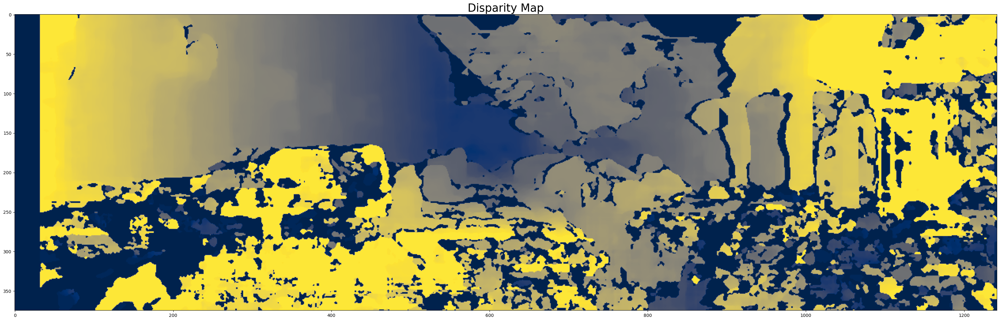

In [37]:
#num_disparities = 96 #(6x16) reduced to 32
left_image = cv2.cvtColor(cv2.imread(left_image_paths[img_index]), cv2.COLOR_BGR2RGB)
right_image = cv2.cvtColor(cv2.imread(right_image_paths[img_index]), cv2.COLOR_BGR2RGB)

left_image_gray = cv2.cvtColor(left_image, cv2.COLOR_RGB2GRAY)
right_image_gray = cv2.cvtColor(right_image, cv2.COLOR_RGB2GRAY)

# Use the below values as initial guesses. Try multiple other combinations.
num_disparities =  32 #(2x16)
block_size = 10
window_size = 100
disparity_stereo = compute_sgbm_disparity(left_image_gray, right_image_gray, num_disparities, block_size, window_size)

plt.figure(figsize = (40,40))
plt.imshow(disparity_stereo, cmap='cividis')
plt.title('Disparity Map', size=25)
plt.show()

# window_size = 100 increased to 300

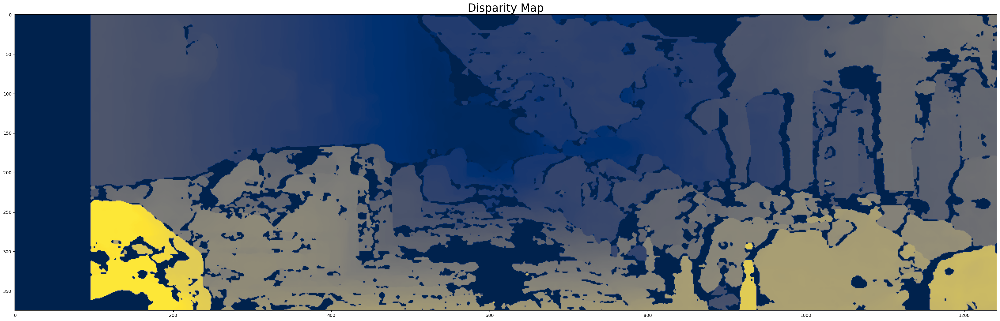

In [38]:
#window_size = 100 increased to 300
left_image = cv2.cvtColor(cv2.imread(left_image_paths[img_index]), cv2.COLOR_BGR2RGB)
right_image = cv2.cvtColor(cv2.imread(right_image_paths[img_index]), cv2.COLOR_BGR2RGB)

left_image_gray = cv2.cvtColor(left_image, cv2.COLOR_RGB2GRAY)
right_image_gray = cv2.cvtColor(right_image, cv2.COLOR_RGB2GRAY)

# Use the below values as initial guesses. Try multiple other combinations.
num_disparities =  96 #(6x16)
block_size = 10
window_size = 300
disparity_stereo = compute_sgbm_disparity(left_image_gray, right_image_gray, num_disparities, block_size, window_size)

plt.figure(figsize = (40,40))
plt.imshow(disparity_stereo, cmap='cividis')
plt.title('Disparity Map', size=25)
plt.show()

# window_size = 100 reduced to 1

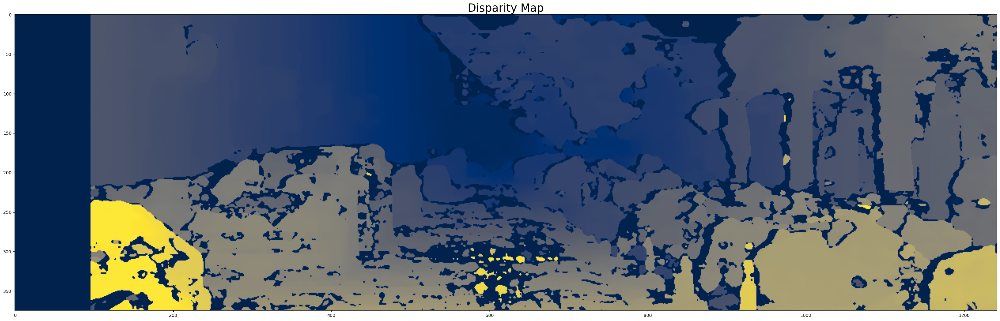

In [39]:
#window_size = 100 reduced to 1
left_image = cv2.cvtColor(cv2.imread(left_image_paths[img_index]), cv2.COLOR_BGR2RGB)
right_image = cv2.cvtColor(cv2.imread(right_image_paths[img_index]), cv2.COLOR_BGR2RGB)

left_image_gray = cv2.cvtColor(left_image, cv2.COLOR_RGB2GRAY)
right_image_gray = cv2.cvtColor(right_image, cv2.COLOR_RGB2GRAY)

# Use the below values as initial guesses. Try multiple other combinations.
num_disparities =  96 #(6x16)
block_size = 10
window_size = 1
disparity_stereo = compute_sgbm_disparity(left_image_gray, right_image_gray, num_disparities, block_size, window_size)

plt.figure(figsize = (40,40))
plt.imshow(disparity_stereo, cmap='cividis')
plt.title('Disparity Map', size=25)
plt.show()

# Best Parameters Selected

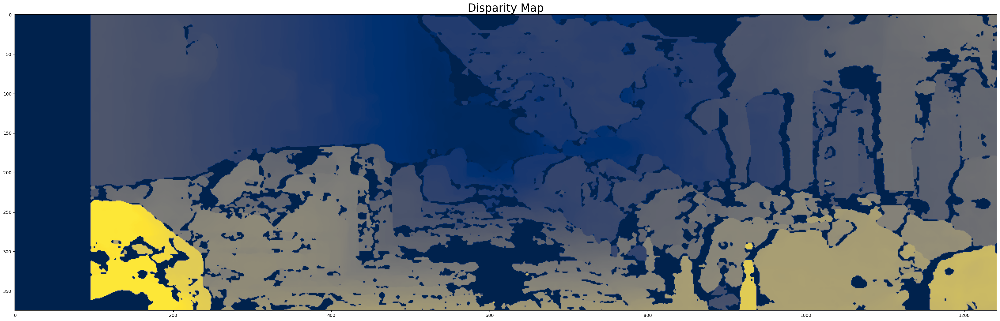

In [41]:
#window_size = 100 increased to 300
left_image = cv2.cvtColor(cv2.imread(left_image_paths[img_index]), cv2.COLOR_BGR2RGB)
right_image = cv2.cvtColor(cv2.imread(right_image_paths[img_index]), cv2.COLOR_BGR2RGB)

left_image_gray = cv2.cvtColor(left_image, cv2.COLOR_RGB2GRAY)
right_image_gray = cv2.cvtColor(right_image, cv2.COLOR_RGB2GRAY)

# Use the below values as initial guesses. Try multiple other combinations.
num_disparities =  96 #(6x16)
block_size = 10
window_size = 300
disparity_stereo = compute_sgbm_disparity(left_image_gray, right_image_gray, num_disparities, block_size, window_size)

plt.figure(figsize = (40,40))
plt.imshow(disparity_stereo, cmap='cividis')
plt.title('Disparity Map', size=25)
plt.show()

<span style="color:red">1. Comment on what effect num_disparities, block_size, and window_size have on the disparity map.</span>

<span style="color:blue">Answer: </span>
1. num_disparities is usually a multiple of 16, the larger the value, the higher the depth resolution, but it will increase the computational cost. Conversely, too low a num_disparities (32) will cause the depth prediction to not work properly. I used a value of 96 (6×16), which means that the maximum measurable depth range is larger

2. The larger the block_size, the less noise there is, but this reduces the detail accuracy (e.g., block_size=15 in the figure) and smoothes out the parallax map. From the above figure, the two sides of the building road signs still maintain a certain level of detail, the ground area is slightly blurred, from the perspective of detail retention, block_size = 10 is relatively good
3.  contrary to block_size, the smaller the window_size is, the greater the random noise. the larger the window_size is, the better the matching effect. But the cost is the loss of details. However, window_size=300 doesn't lose too much detail compared to the reference value of 100, and it filters out some noise, so I chose it as the finalized parameter.

# Part 2c: Compute the disparity between the two images using a pre-trained depth estimation (monodepth 2) algorithm. 
For ease of use, you may continue the assignment using the pre-rectified images from the dataset, i.e., images in 'left_image_paths' and 'right_image_paths'.

https://github.com/nianticlabs/monodepth2


In [17]:
# Helper Function to load and preprocess the image for Monodepth
def load_and_preprocess_image(image_path, resize_width, resize_height):
    image = pil.open(image_path).convert('RGB')
    original_width, original_height = image.size
    image = image.resize((resize_width, resize_height), pil.LANCZOS)
    image = transforms.ToTensor()(image).unsqueeze(0)
    if torch.cuda.is_available():
        return image.cuda(), (original_height, original_width)
    return image, (original_height, original_width)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:135: UserWarning: Using 'weights' as positional parameter(s) is deprecated since 0.13 and may be removed in the future. Please use keyword parameter(s) instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)
<ipython-input-18-8d118abcba01>:9: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`

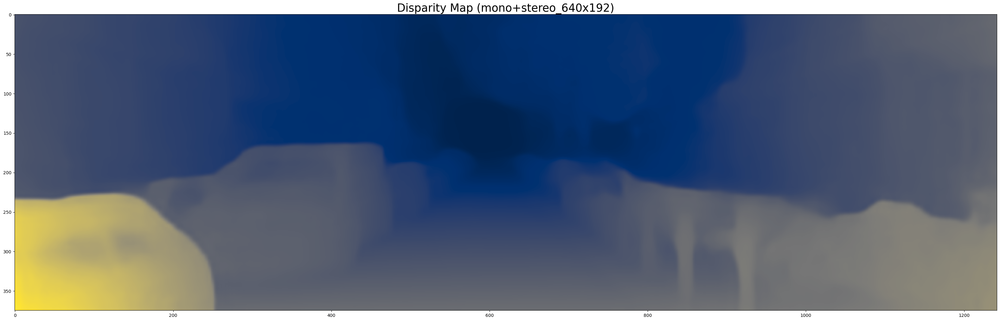

In [18]:
# Load the pretrained model.
model_name = "mono+stereo_640x192"
download_model_if_doesnt_exist(model_name)
encoder_path = os.path.join("models", model_name, "encoder.pth")
depth_decoder_path = os.path.join("models", model_name, "depth.pth")

encoder = ResnetEncoder(18, False)
depth_decoder = DepthDecoder(num_ch_enc=encoder.num_ch_enc, scales=range(4))
loaded_dict_enc = torch.load(encoder_path, map_location='cpu')
filtered_dict_enc = {k: v for k, v in loaded_dict_enc.items() if k in encoder.state_dict()}
encoder.load_state_dict(filtered_dict_enc)
loaded_dict = torch.load(depth_decoder_path, map_location='cpu')
depth_decoder.load_state_dict(loaded_dict)
encoder.eval()
depth_decoder.eval();

# Generate disparity
image_path = left_image_paths[img_index]
resize_height = loaded_dict_enc['height']
resize_width = loaded_dict_enc['width']
image, original_size = load_and_preprocess_image(image_path, resize_width, resize_height)

with torch.no_grad():
    features = encoder(image)
    outputs = depth_decoder(features)

disp = outputs[("disp", 0)]
disp_resized = torch.nn.functional.interpolate(disp, original_size, mode="bilinear", align_corners=False)
disp_resized_np = disp_resized.squeeze().cpu().numpy()
disparity_map_monodepth_2 = disp_resized_np

plt.figure(figsize = (40,40))
plt.imshow(disparity_map_monodepth_2, cmap='cividis')
plt.title('Disparity Map (mono+stereo_640x192)', size=25)
plt.show()


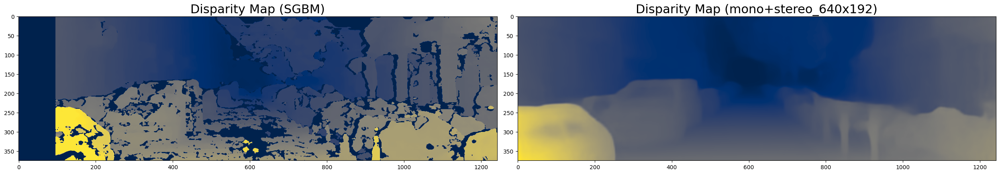

In [19]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(25, 10)) 
ax1.imshow(disparity_stereo, cmap='cividis')
ax1.set_title('Disparity Map (SGBM)', size=22)
ax2.imshow(disparity_map_monodepth_2, cmap='cividis')
ax2.set_title('Disparity Map (mono+stereo_640x192)', size=22)
plt.tight_layout()
plt.show()

# Part 2d: Critique both methods (SGBM & Monodepth) and comment on their performance. 

<span style="color:blue">Answer: </span>1. SGBM requires image pairs that retain information about the edges of objects, and the scene is more structured.However, it is computationally intensive and prone to mis-matching.

Monodepth does not require a binocular camera, so the method is applicable to a wider range of scenes, in addition it is less affected by lighting and can better estimate the depth of a large-scale scene, but the boundaries of objects in the resulting image are more blurred.

2.According to the above figure, the boundaries of the objects in the SGBM image are relatively clear and show clear depth variations, but the ground portion shows a lot of noise, probably due to environmental factors such as lighting.

Monodepth parallax map, roadside objects such as vehicles, road signs, etc., lack clear boundaries and have smoother depth changes.However, it exhibits a more stable estimate of the depth of vision.


# Part 3: Generate Depth Map.

# Part 3a: Generate Depth Map from SGBM Disparity Map

In [20]:
# Complete the function below
def calc_depth_map(disparity_left, intrinsic_left, T_left, T_right):
    # Extract the focal length (fx) from the intrinsic matrix (it is usually at [0, 0])
    fx = intrinsic_left[0, 0]
    
    # Compute the baseline (distance between the two cameras)
    B = np.linalg.norm(T_left - T_right)  # The magnitude of the translation vector
    
    # Replace disparity values of 0 or -1 with a small positive value to avoid division by 0
    disparity_left = np.where(disparity_left <= 0, 1e-5, disparity_left)  # Replace invalid disparity with 1e-5
    
    # Compute the depth map using the formula: Depth = (f * B) / disparity
    depth_map = (fx * B) / disparity_left
    
    return depth_map

In [21]:
# Helper Function
def decompose_projection_matrix(P):    
    K, R, T, _, _, _, _ = cv2.decomposeProjectionMatrix(P)
    T = T/T[3]

    return K, R, T

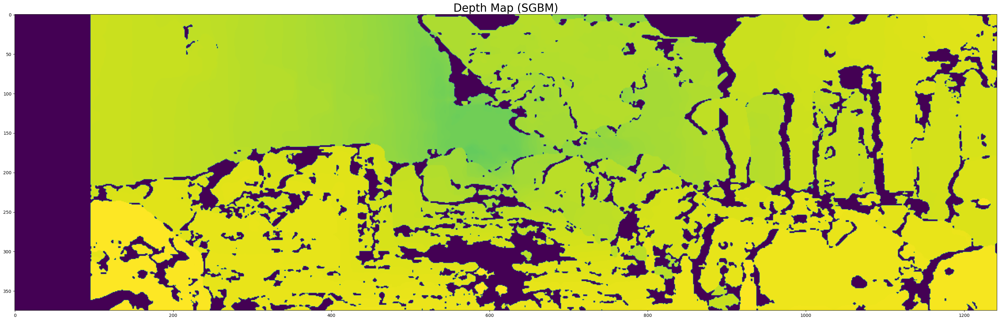

In [22]:
K_left, R_left, T_left = decompose_projection_matrix(P_left)
K_right, R_right, T_right = decompose_projection_matrix(P_right)

depth_map_stereo = calc_depth_map(disparity_stereo, K_left, T_left, T_right)
plt.figure(figsize = (40,40))
plt.imshow(np.log(depth_map_stereo), cmap='viridis_r')
plt.title('Depth Map (SGBM)', size=25)
plt.show()

# Part 3b: Generate Depth Map from Monodepth disparity map.

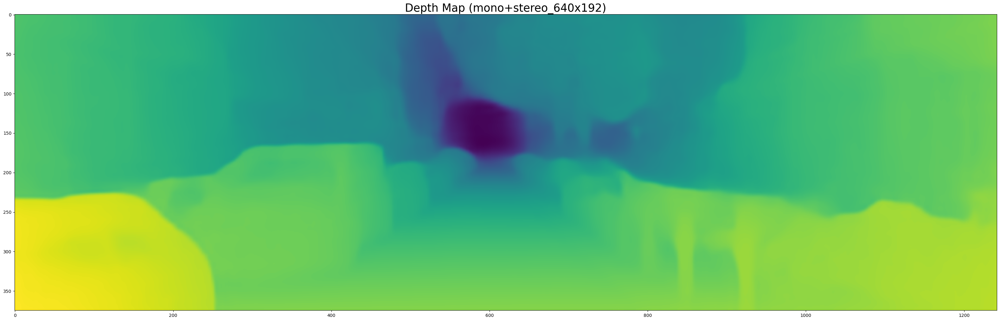

In [23]:
scaled_depth, depth = disp_to_depth(disparity_map_monodepth_2, 0.1, 100)
depth = torch.tensor(depth)
metric_depth = 5.4*depth

plt.figure(figsize = (40,40))
plt.imshow(np.log(metric_depth), cmap='viridis_r')
plt.title('Depth Map (mono+stereo_640x192)', size=25)
plt.show()

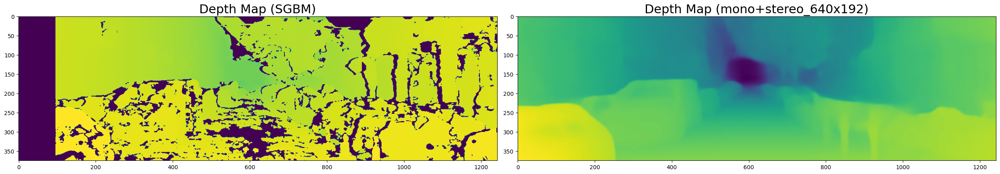

In [24]:
fig, ((ax1, ax2)) = plt.subplots(1, 2, figsize=(25, 15))
ax1.imshow(np.log(depth_map_stereo), cmap='viridis_r')
ax1.set_title('Depth Map (SGBM)', size=22)
ax2.imshow(np.log(metric_depth), cmap='viridis_r')
ax2.set_title('Depth Map (mono+stereo_640x192)', size=22)
plt.tight_layout()  # Adjust layout to prevent overlap if necessary
plt.show()

# Part 3c: Critique both depth maps (SGBM & Monodepth) and comment on their performance. 

<span style="color:blue">Answer: </span>1.The depth map on the left was generated by the SGBM method, with darker regions representing invalid depth/mis-matched regions, yellow representing closer regions, and green representing farther regions.

The Monodepth depth map on the left presents the change from near to far in a more continuous color change (yellow to green and finally to blue)

2.The SGBM depth map show more detail and structure, and depth mutations can be clearly observed, but some noise or discontinuous black areas can be seen in the maps, which may indicate that parallax computation fails in some areas, resulting in inaccurate depth estimation.

Monodepth map have no visible edges or details and are visually smoother, but are less detailed and less accurate, suitable for fast estimation or resource-constrained scenarios, and more dependent on predictions from deep learning models


# Part 4: Generate 2D Detections

Use yolov5 (from ultralytics) to generate 2D Bounding Box detections

Set the confidence and IoU filters to 0.25 

If you use openCV to read in the image you will need to convert from BGR to RGB 

Display the bounding boxes

https://docs.ultralytics.com/yolov5/tutorials/pytorch_hub_model_loading/#simple-example

Using cache found in /root/.cache/torch/hub/ultralytics_yolov5_master
YOLOv5 🚀 2025-2-25 Python-3.10.12 torch-2.5.1+cu121 CPU

Fusing layers... 
YOLOv5s summary: 213 layers, 7225885 parameters, 0 gradients, 16.4 GFLOPs
Adding AutoShape... 
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


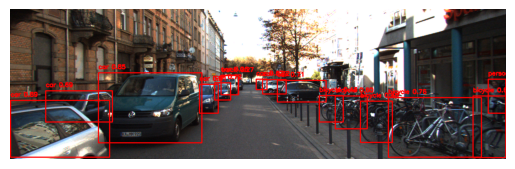

In [26]:
%matplotlib inline
# generate 2D detections
# Load the YOLOv5 model (pretrained on COCO)
model = torch.hub.load('ultralytics/yolov5', 'yolov5s', pretrained=True)

# Set confidence and IoU thresholds
model.conf = 0.25  # Confidence threshold
model.iou = 0.25   # IoU threshold

image = cv2.cvtColor(cv2.imread(left_image_paths[img_index]), cv2.COLOR_BGR2RGB)
results = model(image)

detections = results.pandas()

# Display the image with bounding boxes
for _, row in detections.xyxy[0].iterrows():
    x1, y1, x2, y2, conf, cls = int(row['xmin']), int(row['ymin']), int(row['xmax']), int(row['ymax']), row['confidence'], int(row['class'])
    label = f"{results.names[cls]} {conf:.2f}"
    
    # Draw bounding box
    cv2.rectangle(image, (x1, y1), (x2, y2), (255, 0, 0), 2)
    cv2.putText(image, label, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 0, 0), 2)

# Show the image
plt.imshow(image)
plt.axis("off")
plt.show()

# Part 5. Get Distance from Depth Map (SGBM & Monodepth) and 2D Detections.

There are a number of ways to get depth from a depth map, given a 2D detection. For example, you can find the min, max, or mean depth of that bounding box. However this has certain flaws. A more robust approach is either getting the depth based on the center of the bounding box or getting the median depth of the bounding box.

<span style="color:red">Explain why getting the mean/min/max depth within a 2D detection is a inefficient approach.</span>

<span style="color:blue">Answer: </span>A 2D bounding box may present multiple background areas of different depths. This is especially true in cluttered scenes. Minimum, maximum, or mean depths may not be related to the actual depth of the target object because they do not match the spatial distribution and correlation of depth values. This will lead to errors in depth estimation, where the predicted depth is not related to the real position of the target object.

# Part 5b: Implement an approach that gets the median and center depth within a 2D detection.

In [27]:
# Complete the function below.
def get_distances(image, depth_map, bboxes, method='median', draw=True):
    # Initialize depth array
    depth_arr = []
    
    for bbox in bboxes:
        x1, y1, x2, y2 = map(lambda v: int(float(v)), bbox)  # Convert to integer coordinates
        x_center, y_center = (x1 + x2) // 2, (y1 + y2) // 2
        
        depth_slice = depth_map[y1:y2, x1:x2]  # Extract depth values within bbox
        
        if method == 'center':
            stereo_depth = depth_map[y_center, x_center]  # Depth at center point
        else:
            stereo_depth = np.median(depth_slice)  # Median depth
        
        depth_arr.append(stereo_depth)

        
        if draw:
            cv2.putText(image, '{0:.2f} m'.format(stereo_depth), (x_center, y_center), 
                        cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 0, 0), 2, cv2.LINE_AA)
    
    return image, depth_arr

# Part 5c: Compare the results from the median and center approach.

In [74]:
img_index = 80
left_image = cv2.cvtColor(cv2.imread(left_image_paths[img_index]), cv2.COLOR_BGR2RGB)
right_image = cv2.cvtColor(cv2.imread(right_image_paths[img_index]), cv2.COLOR_BGR2RGB)

bboxes = np.array(detections.xyxy[0].iloc[:, :4].apply(lambda x: list(map(float, x))), dtype=float)
  
_, depth_arr_median = get_distances(left_image, depth_map_stereo, bboxes, method='median', draw=False)
_, depth_arr_center = get_distances(left_image, depth_map_stereo, bboxes, method='center', draw=False)



In [75]:
print("median approach (m)", depth_arr_median)
print("center appraoch (m)", depth_arr_center)

median approach (m) [38437690.0, 8.333374, 15.609213, 6.11335, 35.344997, 25.413345, 21.655035, 8.390218, 6.788112, 10.9236765, 7.365305, 11.171725, 93.899055, 9.549736, 37.730244, 37.730244]
center appraoch (m) [4.102755, 38437690.0, 14.927257, 6.0651183, 34.94335, 25.20504, 21.134123, 8.356019, 6.728698, 9.318227, 7.278142, 11.061205, 58.01915, 9.53493, 37.272907, 37.272907]


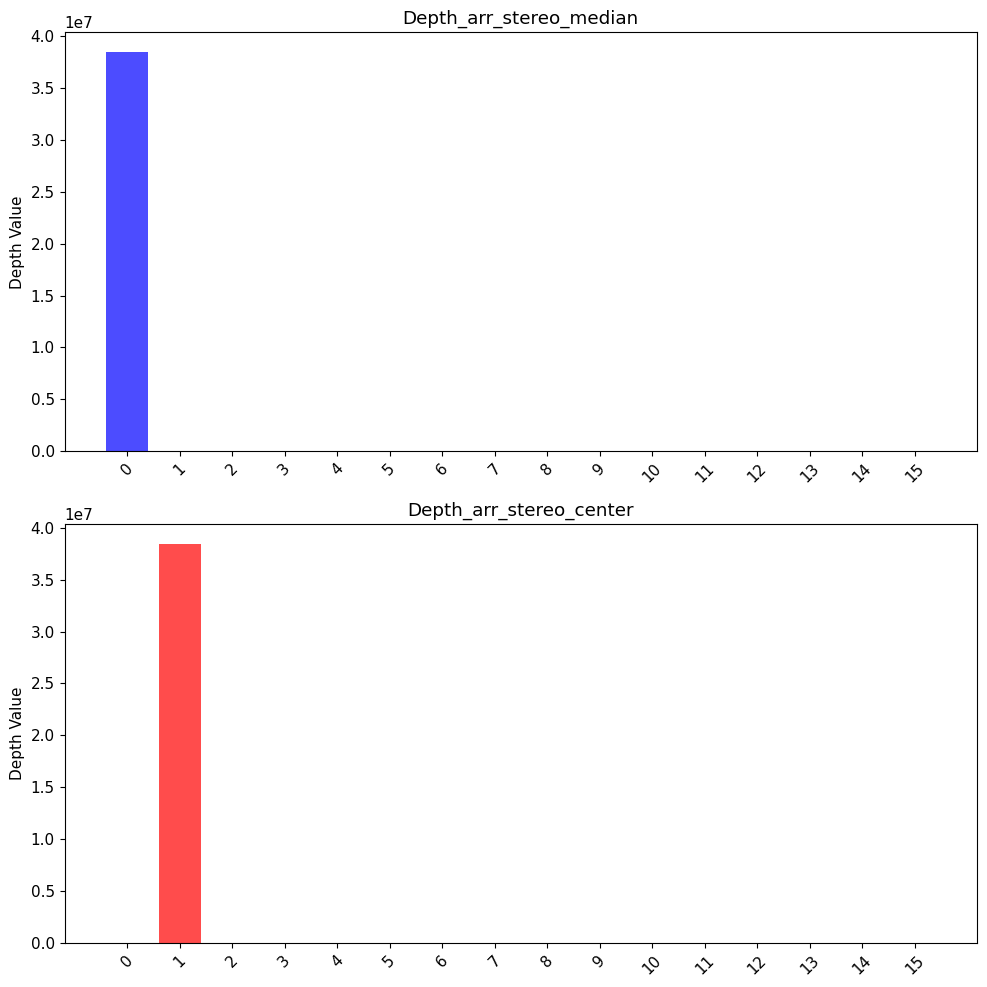

In [76]:

# Create bar plots
x = np.arange(len(depth_arr_median))  # X-axis positions

fig, axs = plt.subplots(2, figsize=(10, 10))
axs[0].bar(x, depth_arr_median, color='b', alpha=0.7)
axs[0].set_title('Depth_arr_stereo_median')

axs[1].bar(x, depth_arr_center, color='r', alpha=0.7)
axs[1].set_title('Depth_arr_stereo_center')

# Set x-axis labels (optional)
for ax in axs:
    ax.set_xticks(x)
    ax.set_xticklabels([str(i) for i in range(len(depth_arr_median))], rotation=45)
    ax.set_ylabel('Depth Value')

# Adjust layout for better visibility
plt.tight_layout()
plt.show()

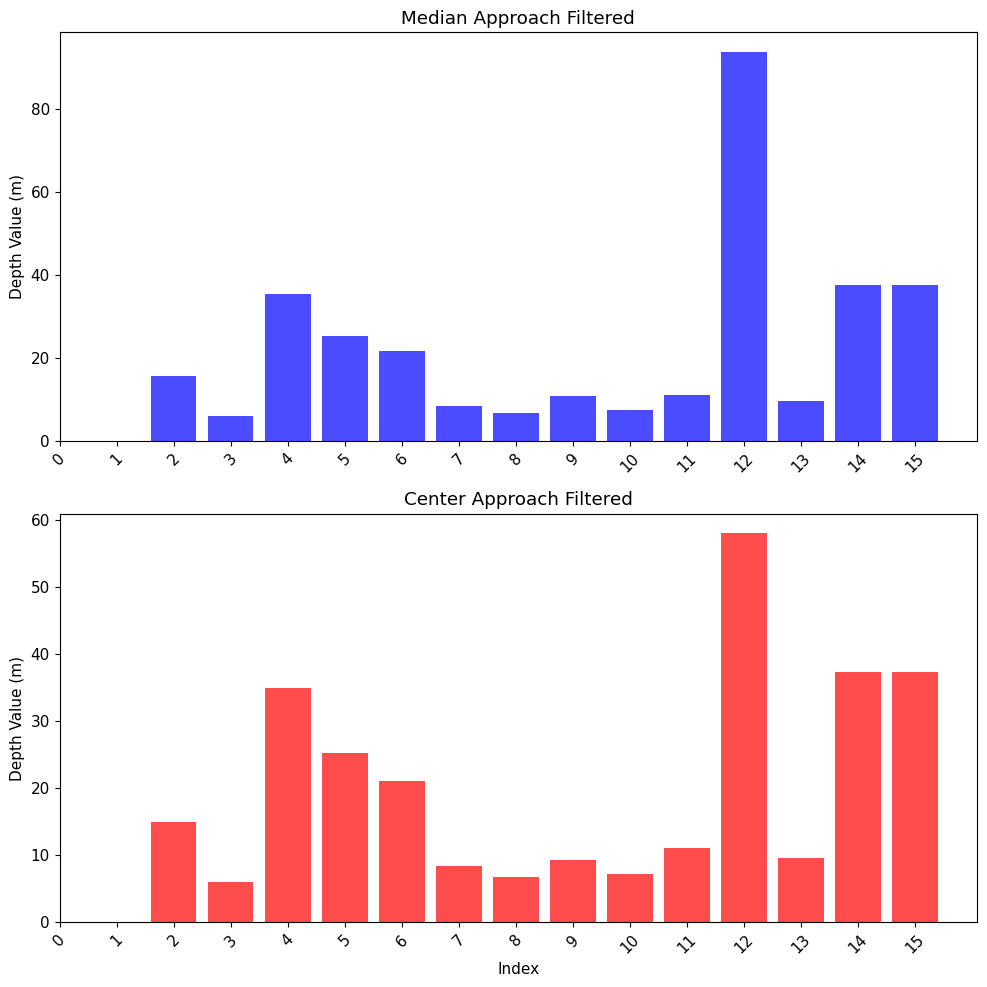

In [85]:

# Indices to remove: 
threshold = 1e6  

filtered_median = [val if val < threshold else 10 for val in depth_arr_median]
filtered_center = [val if val < threshold else 10 for val in depth_arr_center]

# If the center results are obviously wrong remove them 
indices_with_gaps = {0,1}

# Replace values at these indices with np.nan to create gaps
modified_median = [val if i not in indices_with_gaps else np.nan for i, val in enumerate(depth_arr_median)]
modified_center = [val if i not in indices_with_gaps else np.nan for i, val in enumerate(depth_arr_center)]

# X-axis positions
x = np.arange(len(modified_median))

# Create subplots
fig, axs = plt.subplots(2, figsize=(10, 10))

# Plot modified data (with gaps)
axs[0].bar(x, modified_median, color='b', alpha=0.7)
axs[0].set_title('Median Approach Filtered')

axs[1].bar(x, modified_center, color='r', alpha=0.7)
axs[1].set_title('Center Approach Filtered')

# Set x-axis labels
for ax in axs:
    ax.set_xticks(x)
    ax.set_xticklabels([str(i) for i in range(len(modified_median))], rotation=45)
    plt.xlabel('Index')
    ax.set_ylabel('Depth Value (m)')

# Adjust layout
plt.tight_layout()
plt.show()

# Part 5d: Comment on the difference between the two methods (median/center).

<span style="color:blue">Answer: </span>From the first set of output bar graphs, there are significant outliers in the depth estimates, and the following analysis is based on the set of bar graphs after I removed the outliers.

The blue bars represent the median approach, with depth values predominantly distributed between 0 and 80 meters, with the majority of values within 10 to 40 meters, with index 11 having significantly higher depth values than the other points, reaching approximately 80 meters.

The red bars represent Center Approach, and the distribution trend is similar to that of the Median bars, with the overall depth value slightly lower than that of the Median Approach, and the distribution is relatively more stable

# Part 6: Compare Estimated Depth to LiDAR Ground Truth.

In [62]:
# Helper Function
def project_velo2cam(lidar_bin, image):
    ''' Projects LiDAR point cloud onto the image coordinate frame '''

    # get camera (u, v, z) coordinates
    velo_camera = get_velo2cam(lidar_bin)

    (u, v, z) = velo_camera

    # remove outliers (points outside of the image frame)
    img_h, img_w, _ = image.shape
    u_out = np.logical_or(u < 0, u > img_w)
    v_out = np.logical_or(v < 0, v > img_h)
    outlier = np.logical_or(u_out, v_out)
    velo_camera = np.delete(velo_camera, np.where(outlier), axis=1)
    
    return velo_camera

In [78]:
# Helper Function
def get_velo2cam(lidar_bin):
    ''' Converts the LiDAR point cloud to camera (u, v, z) image coordinates, 
        where z is in meters
        '''
    # read in LiDAR data
    scan_data = np.fromfile(lidar_bin, dtype=np.float32).reshape((-1,4))

    # convert to homogeneous coordinate system
    velo_points = scan_data[:, 0:3] # (x, y, z) --> (front, left, up)
    velo_points = np.insert(velo_points, 3, 1, axis=1).T # homogeneous LiDAR points

    # delete negative liDAR points
    velo_points = np.delete(velo_points, np.where(velo_points[3, :] < 0), axis=1) 

    # possibly use RANSAC to remove the ground plane for better viewing?

    # convert to camera coordinates 
    velo_camera = P_left @ R_left_rect @ T_cam_velo @ velo_points


    # delete negative camera points ??
    velo_camera  = np.delete(velo_camera , np.where(velo_camera [2,:] < 0)[0], axis=1) 

    # get camera coordinates u,v,z
    velo_camera[:2] /= velo_camera[2, :]

    return velo_camera

# Part 6a: Get LiDAR Ground Truth given a 2D bounding box.

In [79]:
# Complete the function below.
def get_lidar_gt(bboxes, velo_camera):
    # This function will get the distance from the LiDAR for the 2D Detection.

    gt_depth_lidar_arr = []
    
    # unpack LiDAR camera coordinates
    u, v, z = velo_camera

    for bbox in bboxes:
        # get pt1 (x1, y1) and pt2 (x2, y2) ... same as in def get_distances
        y1, x1, y2, x2 = map(lambda v: int(float(v)), np.round(bbox))  # Convert to integer coordinates
        x_center, y_center = (x1 + x2) // 2, (y1 + y2) // 2


        # get center location on image (y_center, x_center) ... same as in the function get_distances
        _, depth_arr_median = get_distances(left_image, depth_map_stereo, bboxes, method='median', draw=False)
        _, depth_arr_center = get_distances(left_image, depth_map_stereo, bboxes, method='center', draw=False)

        # now get the closest LiDAR points to the center
        center_delta = np.abs(np.array((v, u))- np.array([[x_center, y_center]]).T)
        
        # choose coordinate pair with the smallest L2 norm
        min_loc = np.argmin(np.linalg.norm(center_delta, axis=0))

        velo_depth = z[min_loc]
        gt_depth_lidar_arr.append(velo_depth)

    return gt_depth_lidar_arr

In [80]:
bboxes = np.array(detections.xyxy[0].iloc[:, :4].apply(lambda x: list(map(float, x))), dtype=float)
lidar_bin = bin_paths[img_index]

R_left_rect = np.array([float(x) for x in cam_calib[24].strip().split(' ')[1:]]).reshape((3, 3,))
R_left_rect = np.insert(R_left_rect, 3, values=[0,0,0], axis=0)
R_left_rect = np.insert(R_left_rect, 3, values=[0,0,0,1], axis=1)

velo_camera = project_velo2cam(lidar_bin, left_image)

gt_depth_lidar_arr = get_lidar_gt(bboxes, velo_camera)

LiDAR Ground Truth [3.598712832396921, 7.232309344406232, 14.858922791508325, 6.79011014002295, 34.51072420640012, 24.459894014999602, 20.616937683365485, 9.82306134697955, 8.478990451845394, 11.274498984425268, 10.08206912215889, 10.817711370343245, 56.108135711533315, 9.193014866835949, 36.090959275250555, 36.090959275250555]


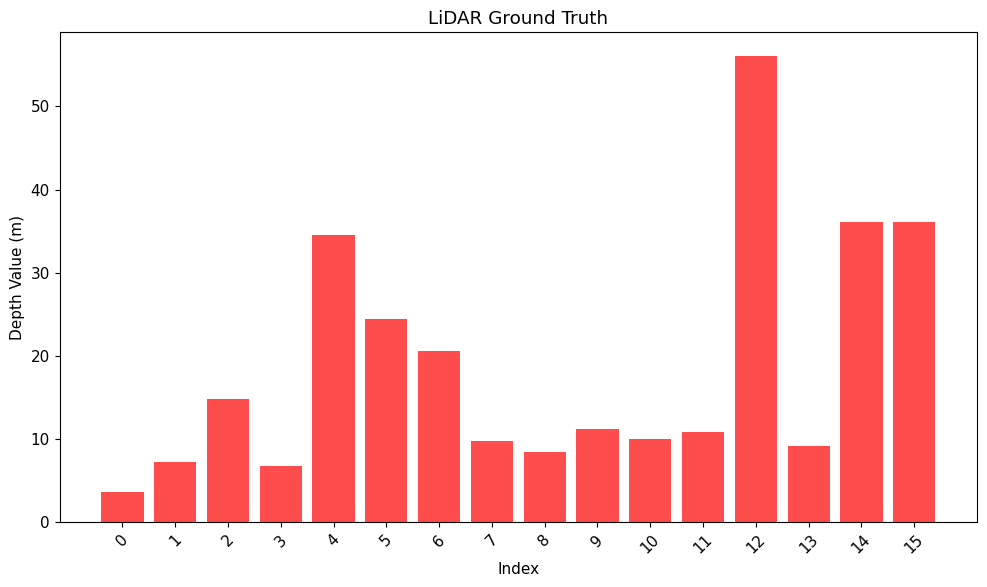

In [81]:
print("LiDAR Ground Truth", gt_depth_lidar_arr)

# Create bar plots
x = np.arange(len(gt_depth_lidar_arr))  # X-axis positions

# Create figure and plot a single bar chart
plt.figure(figsize=(10, 6))
plt.bar(x, gt_depth_lidar_arr, color='r', alpha=0.7)

# Titles and labels
plt.title('LiDAR Ground Truth')
plt.xlabel('Index')
plt.ylabel('Depth Value (m)')

# Set x-axis labels
plt.xticks(x, [str(i) for i in range(len(gt_depth_lidar_arr))], rotation=45)

# Adjust layout and display
plt.tight_layout()
plt.show()

# Part 6b: Compare LiDAR GT to depth maps.

Stereo Depth (SGBM) [nan, 8.333374, 15.609213, 6.11335, 35.344997, 25.413345, 21.655035, 8.390218, 6.788112, 10.9236765, 7.365305, 11.171725, 93.899055, 9.549736, 37.730244, 37.730244]


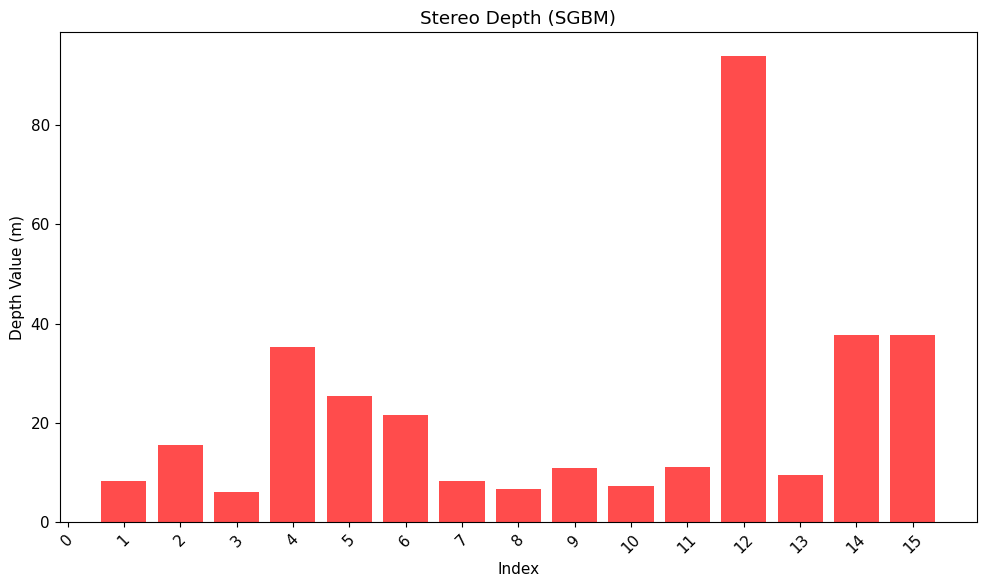

In [82]:
bboxes = np.array(detections.xyxy[0].iloc[:, :4].apply(lambda x: list(map(float, x))), dtype=float)
left_image_stereo, depth_arr_stereo = get_distances(left_image, depth_map_stereo, bboxes, method='median', draw=True)

indices_with_gaps = {0}

# Replace values at these indices with np.nan to create gaps
depth_arr_stereo = [val if i not in indices_with_gaps else np.nan for i, val in enumerate(depth_arr_stereo)]


print("Stereo Depth (SGBM)", depth_arr_stereo)

# 创建条形图
x = np.arange(len(depth_arr_stereo))  # X 轴索引

plt.figure(figsize=(10, 6))
plt.bar(x, depth_arr_stereo, color='r', alpha=0.7)

# 设置标题和标签
plt.title('Stereo Depth (SGBM)')
plt.xlabel('Index')
plt.ylabel('Depth Value (m)')

# 设置 x 轴刻度
plt.xticks(x, [str(i) for i in range(len(gt_depth_lidar_arr))], rotation=45)

# 调整布局并显示
plt.tight_layout()
plt.show()

Monodepth [3.560225, 8.207353, 15.077024, 5.4186373, 30.314068, 23.193977, 17.430622, 7.092721, 4.7044888, 7.0520954, 6.2789536, 7.8071117, 56.196922, 6.763788, 32.02214, 32.39672]


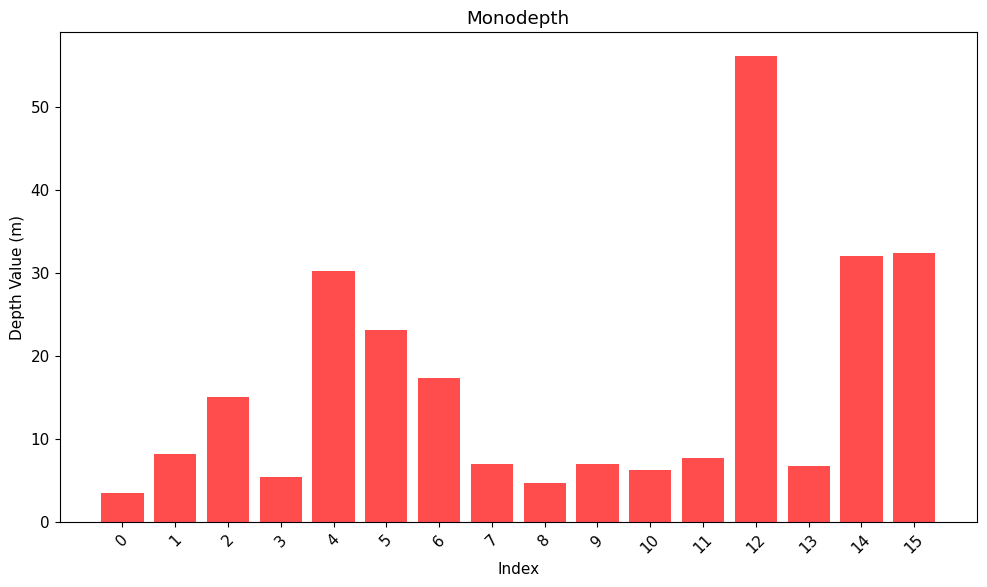

In [83]:
bboxes = np.array(detections.xyxy[0].iloc[:, :4].apply(lambda x: list(map(float, x))), dtype=float)
left_image_monodepth, depth_arr_monodepth = get_distances(left_image, metric_depth, bboxes, method='median', draw=True)


print("Monodepth", depth_arr_monodepth)

# 创建条形图
x = np.arange(len(depth_arr_monodepth))  # X 轴索引

plt.figure(figsize=(10, 6))
plt.bar(x, depth_arr_monodepth, color='r', alpha=0.7)

# 设置标题和标签
plt.title('Monodepth')
plt.xlabel('Index')
plt.ylabel('Depth Value (m)')

# 设置 x 轴刻度
plt.xticks(x, [str(i) for i in range(len(gt_depth_lidar_arr))], rotation=45)

# 调整布局并显示
plt.tight_layout()
plt.show()

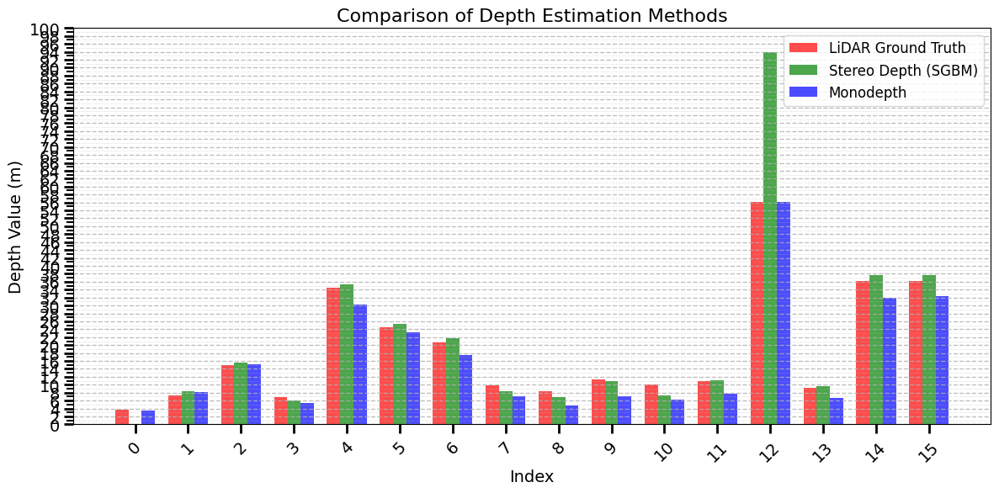

In [84]:
import numpy as np
import matplotlib.pyplot as plt

# Ensure all arrays have the same length (adjust if necessary)
num_values = min(len(gt_depth_lidar_arr), len(depth_arr_stereo), len(depth_arr_monodepth))

# Trim arrays to the same minimum length
gt_depth_lidar_arr = gt_depth_lidar_arr[:num_values]
depth_arr_stereo = depth_arr_stereo[:num_values]
depth_arr_monodepth = depth_arr_monodepth[:num_values]

# X-axis positions
x = np.arange(num_values)  

# Set bar width
bar_width = 0.25  

# Create figure
plt.figure(figsize=(12, 6))

plt.bar(x, gt_depth_lidar_arr, width=bar_width, color='r', alpha=0.7, label='LiDAR Ground Truth')
plt.bar(x + bar_width, depth_arr_stereo, width=bar_width, color='g', alpha=0.7, label='Stereo Depth (SGBM)')
plt.bar(x + 2 * bar_width, depth_arr_monodepth, width=bar_width, color='b', alpha=0.7, label='Monodepth')

# Titles and labels
plt.title('Comparison of Depth Estimation Methods', fontsize=16)
plt.xlabel('Index', fontsize=14)
plt.ylabel('Depth Value (m)', fontsize=14)

# Adjust x-axis labels to be centered with increased fontsize
plt.xticks(x + bar_width, [str(i) for i in range(num_values)], rotation=45, fontsize=12)
plt.yticks(fontsize=12)  # Increase Y-axis tick label size

# Set major Y-axis ticks every 2 meters (with labels)
y_min, y_max = plt.ylim()  
plt.yticks(np.arange(0, y_max + 2, 2))

# Add minor ticks every 1 meter
plt.gca().yaxis.set_minor_locator(plt.MultipleLocator(1))

# Increase major tick size and width
plt.tick_params(axis='both', which='major', labelsize=14, length=8, width=2)

# Increase minor tick size and width (no labels for minor ticks)
plt.tick_params(axis='y', which='minor', length=6, width=1.5, labelsize=0)

# Add grid lines for better readability
plt.grid(axis='y', which='major', linestyle='--', linewidth=1, alpha=0.8)  # Major grid lines
plt.grid(axis='y', which='minor', linestyle=':', linewidth=0.6, alpha=0.6)  # Minor grid lines

# Add legend with larger font size
plt.legend(fontsize=12)

# Adjust layout and display
plt.tight_layout()
plt.show()

Add a few comments discussing the relative performance of each depth map. Compare them with the LiDAR ground truth

<span style="color:blue">Answer: </span>
Depth bar graphs generated from lidar measurements were used as a reference，
1.The histograms generated by the SGBM method have more obvious errors, firstly, no depth is predicted at index 0, and the predicted depth value is much higher than the actual depth at index12，This may be due to smaller values of block_size or num_disparities, making the depth resolution lower and more noisy.

2.Depth maps generated by the Monodepth approach perform relatively better, with depth estimates generally slightly lower than actual values,possibly because of a systematic bias in depth prediction in the model training data.

Monodepth performs relatively better overall, and SGBM can be improved by tweaking variables, so there is more space for optimization